# 1. Geodemografía de Nueva York
Se intentarpa obtener la escencia geomeografica de la ciudad de Nueva York. Para esto, usaremos los datos del censo de la ciudad, usado en lecciones anteriores. Una vez cargada esta información, crea una clasificación geodemogrfáfica
usando las siguientes variables.

-european: Total Population White

-asian: Total Population Asian American

-american: Total Population American Indian

-african: Total Population African American

-hispanic: Total Population Hispanic

-mixed: Total Population Mixed race

-pacific: Total Population Pacific Islander

Para esto, estandariza la información para cada uno de los campos, esto, respecto a la población total de cada una de las entidades dentro del censo, de esta forma los valores se encontraran en el rango de 0 y 1
Un avez hecho esto, realiza lo siguiente:

Elige un número de clusters
Corre el algoritmo Kmeans
Visualiza la clasificación
Analiza los resultados, y responde lo siguiente:
- ¿Que encontraste?
- ¿Cuales son las principales caracteristicas de cada cluster?
- ¿Cómo se encuentran distribuidos geografícamente cada uno de los clusters?
- ¿Se puede identificar alguna concentración de grupos etnicos en el territorio?

# Iniciamos
## Cargamos librerías


In [12]:
# Ajusta el tamalo de los graficos al de la ventana
%matplotlib inline

# Visualización de datos
import seaborn as sns
# Trabajo de bases de datos
import pandas as pd
# Analisis espacial
from pysal.lib import weights
# Datos de ejemplo de pysal
from pysal.lib import examples
# Trabajo de información tabular geografíca
import geopandas as gpd
# Mapas base
import contextily as cx
# Cosas matemáticas
import numpy as np
# Visualización de datos
import matplotlib.pyplot as plt
# Machine Learning
from sklearn import cluster
# Algoritmo kmeans
from sklearn.cluster import KMeans
# Calculo de distancia entre puntos
from scipy.spatial.distance import cdist

# Preprocesamiento de la información

AxesSubplot(0.125,0.20997;0.775x0.585059)


,UNEMP_RATE,cartodb_id,withssi,withsocial,withpubass,struggling,profession,popunemplo,poptot,popover18,...,geo_geoid,shape_leng,shape_area,ct2010,boroct2010,borocode,tractid,popdty,geo_fips,geometry
0,0.000000,1,0,0,0,0,0,0,0,0,...,08000US360614491951000000100,11023.047911,1.844421e+06,100.0,1000100.0,1.0,1.00,0.00,3.606140e+20,"MULTIPOLYGON (((-74.04388 40.69019, -74.04351 ..."
1,0.081705,2,228,353,47,694,0,92,2773,2351,...,08000US360614491951000000201,4748.703641,9.716282e+05,201.0,1000201.0,1.0,2.01,79619.05,3.606140e+20,"POLYGON ((-73.98450 40.70951, -73.98655 40.709..."
2,0.170603,3,658,1577,198,2589,36,549,8339,6878,...,08000US360614491951000000202,8568.208357,3.315121e+06,202.0,1000202.0,1.0,2.02,72326.46,3.606140e+20,"MULTIPOLYGON (((-73.98237 40.70554, -73.98246 ..."
3,0.000000,4,0,0,0,0,0,0,0,0,...,08000US360614491951000000500,32407.899284,9.081808e+06,500.0,1000500.0,1.0,5.00,0.00,3.606140e+20,"MULTIPOLYGON (((-74.01093 40.68449, -74.01193 ..."
4,0.088037,5,736,1382,194,2953,19,379,10760,8867,...,08000US360614491951000000600,6973.204078,2.583270e+06,600.0,1000600.0,1.0,6.00,109785.00,3.606140e+20,"POLYGON ((-73.99022 40.71440, -73.98934 40.714..."


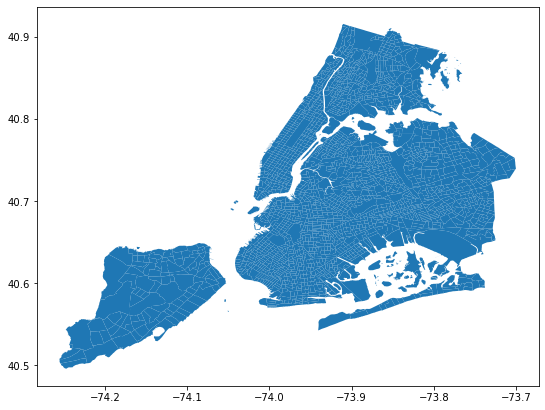

In [3]:
# Descarga la información de ejemplo de la librería pysal
nyc_data = examples.load_example("NYC Socio-Demographics")
# Imprime las rutas de los archivos de ejemplo para poder acceder a ellos
nyc_data.get_file_list()
# Cargamos la información
nyc = gpd.read_file(nyc_data.get_path("NYC_Tract_ACS2008_12.shp"))
# Visualizamos geometrías
print (nyc.plot(figsize=(9, 9)))
# Visualizamos información tabular
nyc.head()

In [4]:
# De antemano, sabemos que columnas nos interesan, creémos una variable que contenga el nombre de las columnas de interes para usarlas como filtro y extraerlas de la base de datos
interest = ['geo_geoid','european', 'asian', 'american', 'african', 'hispanic', 'pacific', 'mixed', 'geometry',]
etnics = ['european', 'asian', 'american', 'african', 'hispanic', 'pacific', 'mixed']
# Aplicamos el filtro
nyc =  nyc[interest]
# Visualizamos tabla
nyc.head()

,geo_geoid,european,asian,american,african,hispanic,pacific,mixed,geometry
0,08000US360614491951000000100,0,0,0,0,0,0,0,"MULTIPOLYGON (((-74.04388 40.69019, -74.04351 ..."
1,08000US360614491951000000201,540,1249,43,168,1187,0,175,"POLYGON ((-73.98450 40.70951, -73.98655 40.709..."
2,08000US360614491951000000202,4091,1724,0,1115,3503,0,234,"MULTIPOLYGON (((-73.98237 40.70554, -73.98246 ..."
3,08000US360614491951000000500,0,0,0,0,0,0,0,"MULTIPOLYGON (((-74.01093 40.68449, -74.01193 ..."
4,08000US360614491951000000600,1181,6549,57,910,2608,13,251,"POLYGON ((-73.99022 40.71440, -73.98934 40.714..."


In [5]:
# Creamos columna de población total apartir de la suma de la población por etnia
nyc['pobtot'] = nyc[etnics].sum(axis=1)
# Visualizamos
nyc.head()

,geo_geoid,european,asian,american,african,hispanic,pacific,mixed,geometry,pobtot
0,08000US360614491951000000100,0,0,0,0,0,0,0,"MULTIPOLYGON (((-74.04388 40.69019, -74.04351 ...",0
1,08000US360614491951000000201,540,1249,43,168,1187,0,175,"POLYGON ((-73.98450 40.70951, -73.98655 40.709...",3362
2,08000US360614491951000000202,4091,1724,0,1115,3503,0,234,"MULTIPOLYGON (((-73.98237 40.70554, -73.98246 ...",10667
3,08000US360614491951000000500,0,0,0,0,0,0,0,"MULTIPOLYGON (((-74.01093 40.68449, -74.01193 ...",0
4,08000US360614491951000000600,1181,6549,57,910,2608,13,251,"POLYGON ((-73.99022 40.71440, -73.98934 40.714...",11569


In [6]:
# Se crea una variable que tendrá los porcentajes para cada etnia
pcts = nyc[etnics].divide(nyc["pobtot"], axis=0) * 100
# Join entre tabla de etnias y tabla base
nyc = nyc.join(pcts, rsuffix="_pct")
# Visualizamos
nyc.head()

,geo_geoid,european,asian,american,african,hispanic,pacific,mixed,geometry,pobtot,european_pct,asian_pct,american_pct,african_pct,hispanic_pct,pacific_pct,mixed_pct
0,08000US360614491951000000100,0,0,0,0,0,0,0,"MULTIPOLYGON (((-74.04388 40.69019, -74.04351 ...",0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,08000US360614491951000000201,540,1249,43,168,1187,0,175,"POLYGON ((-73.98450 40.70951, -73.98655 40.709...",3362,16.061868,37.150506,1.279001,4.997026,35.306365,0.000000,5.205235
2,08000US360614491951000000202,4091,1724,0,1115,3503,0,234,"MULTIPOLYGON (((-73.98237 40.70554, -73.98246 ...",10667,38.351927,16.161995,0.000000,10.452798,32.839599,0.000000,2.193681
3,08000US360614491951000000500,0,0,0,0,0,0,0,"MULTIPOLYGON (((-74.01093 40.68449, -74.01193 ...",0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,08000US360614491951000000600,1181,6549,57,910,2608,13,251,"POLYGON ((-73.99022 40.71440, -73.98934 40.714...",11569,10.208315,56.608177,0.492696,7.865848,22.543003,0.112369,2.169591


In [7]:
# Creamos una variable que contenga solo los valores de porcentaje
ethnicity_pcts = [i + "_pct" for i in etnics]
#
nyc[ethnicity_pcts].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2166 entries, 0 to 2165
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   european_pct  2126 non-null   float64
 1   asian_pct     2126 non-null   float64
 2   american_pct  2126 non-null   float64
 3   african_pct   2126 non-null   float64
 4   hispanic_pct  2126 non-null   float64
 5   pacific_pct   2126 non-null   float64
 6   mixed_pct     2126 non-null   float64
dtypes: float64(7)
memory usage: 118.6 KB


In [8]:
# Removemos las filas con valores nulos y creamos una variable que contenga estos datos
nyc_to_cluster = nyc[ethnicity_pcts + ["geometry"]]\
                    .dropna()

In [10]:
nyc_codo = nyc[ethnicity_pcts].dropna()
nyc_codo.head()

,european_pct,asian_pct,american_pct,african_pct,hispanic_pct,pacific_pct,mixed_pct
1,16.061868,37.150506,1.279001,4.997026,35.306365,0.000000,5.205235
2,38.351927,16.161995,0.000000,10.452798,32.839599,0.000000,2.193681
4,10.208315,56.608177,0.492696,7.865848,22.543003,0.112369,2.169591
5,68.281636,21.932473,0.013725,1.564645,5.133132,0.000000,3.074389
6,8.526065,86.710720,0.000000,0.789280,2.918502,0.000000,1.055433


# Kmeans
Antes de iniciar plenamente el algorimo necesitamos identificar el número de clusters optimo para nuestros datos, para esto, haremos uso del método del codo, el cual es estimado mediante el quiebre de una curva

In [19]:
distortions = []
inertias = []
mapping1 = {}
mapping2 = {}
K = range(1, 10)
 
for k in K:
    # Building and fitting the model
    kmeanModel = KMeans(n_clusters=k).fit(nyc_codo)
    kmeanModel.fit(nyc_codo)
 
    distortions.append(sum(np.min(cdist(nyc_codo, kmeanModel.cluster_centers_,
                                        'euclidean'), axis=1)) / nyc_codo.shape[0])
    inertias.append(kmeanModel.inertia_)
 
    mapping1[k] = sum(np.min(cdist(nyc_codo, kmeanModel.cluster_centers_,
                                   'euclidean'), axis=1)) / nyc_codo.shape[0]
    mapping2[k] = kmeanModel.inertia_

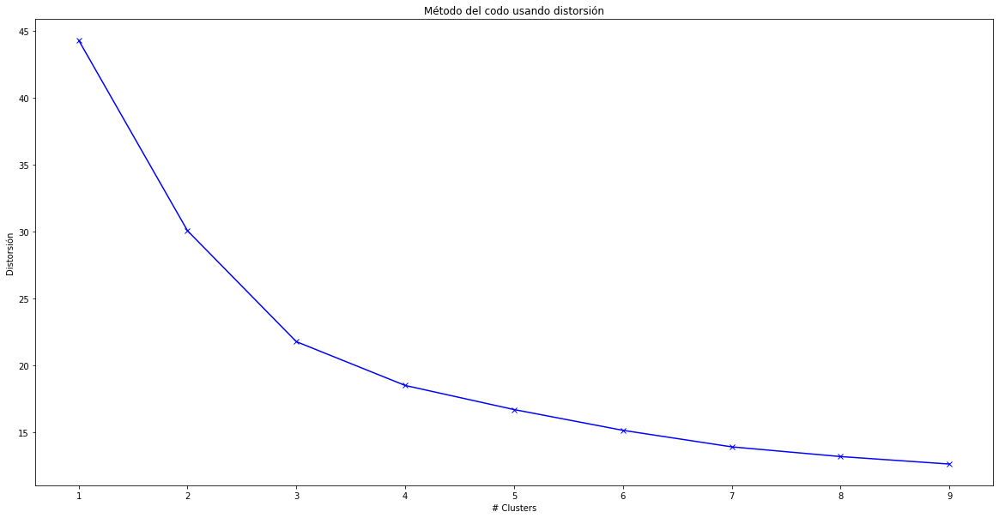

In [22]:
plt.figure(figsize=(20,10))
plt.plot(K, distortions, 'bx-')
plt.xlabel('# Clusters')
plt.ylabel('Distorsión')
plt.title('Método del codo usando distorsión')
plt.show()

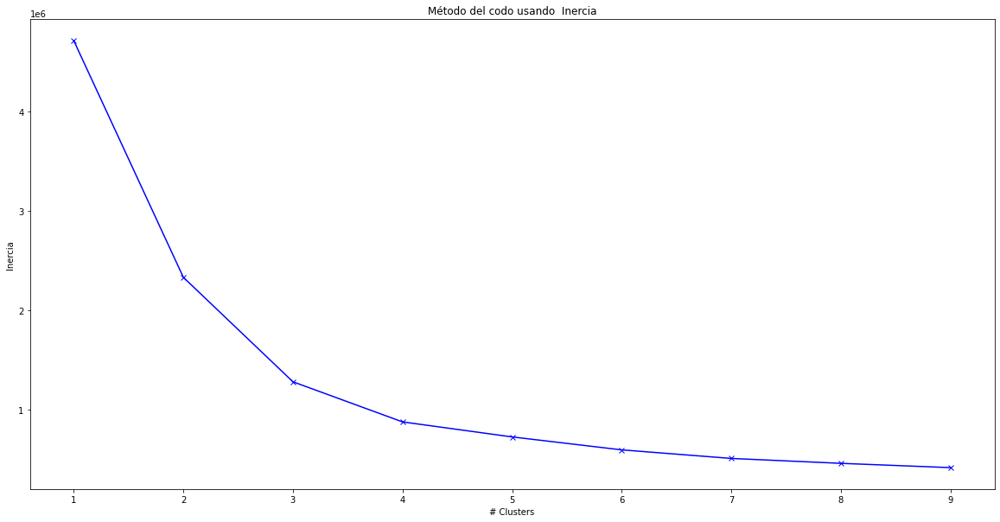

In [23]:
plt.figure(figsize=(20,10))
plt.plot(K, inertias, 'bx-')
plt.xlabel('# Clusters')
plt.ylabel('Inercia')
plt.title('Método del codo usando  Inercia')
plt.show()

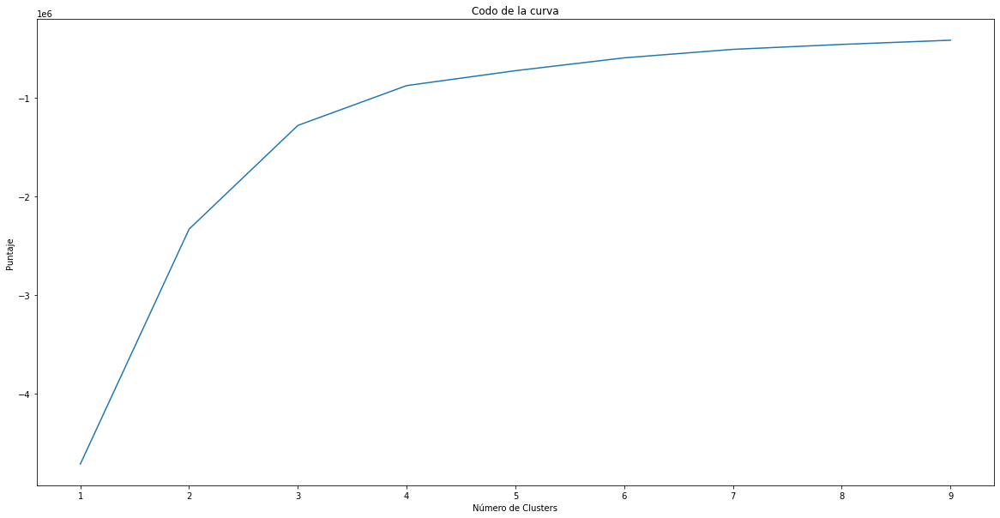

In [24]:
# Establecemos el rango minimo y maximo de clusters
Nc = range(1, 10)
# Establecemos la interación de acuerdo al rango anterior
kmeans = [KMeans(n_clusters=i) for i in Nc]
# Proceso que identifica el número optimo de clusters
score = [kmeans[i].fit(nyc_codo).score(nyc_codo) for i in range(len(kmeans))]
# Graficamos
plt.figure(figsize=(20,10))
plt.plot(Nc,score)
plt.xlabel('Número de Clusters')
plt.ylabel('Puntaje')
plt.title('Codo de la curva')
plt.show()

De acuerdo a lo visualizado en el método del codo, usando tanto la inercia como la ditorsión, se puede concluir que el número optimo de clusters es de cuatro, esto a pesar de tener un número mayor de clases  (etnias)

In [25]:
#Establecemos el número de clusters = 4
kmeans4 = cluster.KMeans(n_clusters=4, random_state=12345)
# Corremos kmeans
k4cls = kmeans4.fit(nyc_to_cluster[ethnicity_pcts])
#Agregamos etiquetas a la base 
nyc_to_cluster['k4cls'] = k4cls.labels_

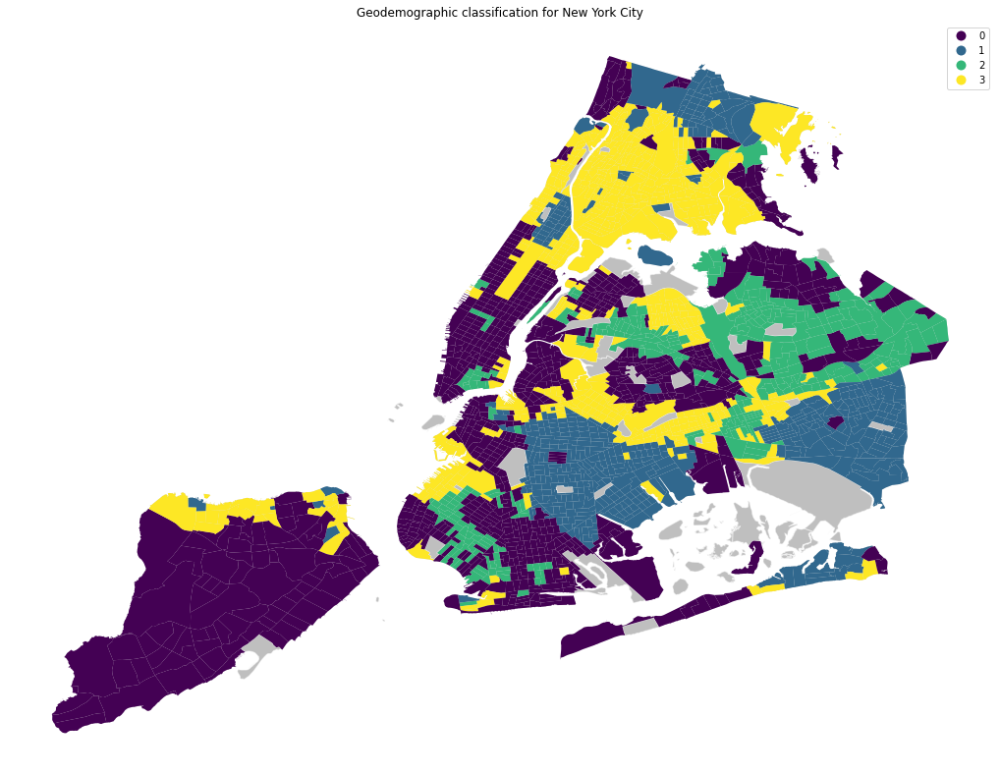

In [28]:
# Setup figure and ax
f, ax = plt.subplots(1, figsize=(18, 18))
# Plot underlying geometries of all areas 
#in light grey and white borders
nyc.plot(ax=ax, 
         facecolor="grey", 
         edgecolor="w", 
         alpha=0.5
        )
# Plot unique values choropleth including 
#a legend and with no boundary lines
nyc_to_cluster.plot(column='k4cls', 
                    categorical=True, 
                    cmap="viridis",
                    legend=True, 
                    linewidth=0, 
                    ax=ax
                   )
# Remove axis
ax.set_axis_off()
# Add title
plt.title('Geodemographic classification for New York City')
# Display the map
plt.show()

In [33]:
# Caracteristicas de los clusters
# Número de entidades por cluster
k4sizes = nyc_to_cluster.groupby('k4cls').size()
k4sizes

k4cls
0    791
1    474
2    312
3    549
dtype: int64

In [30]:
# Calcular el promedio de proporción de población por etnia
k4means = nyc_to_cluster.groupby('k4cls')[ethnicity_pcts].mean()
k4means.index.name = "Clusters"
k4means.columns.name = "Variables"
# Show the table transposed (so it's not too wide)
k4means.T

Clusters,0,1,2,3
Variables,,,,
european_pct,71.993725,8.540014,32.325313,23.491537
asian_pct,9.543878,2.680201,40.517732,5.553391
american_pct,0.238404,0.264222,0.562932,0.463962
african_pct,3.940603,73.836969,5.742206,20.479552
hispanic_pct,12.350245,12.480881,17.928104,46.882645
pacific_pct,0.037848,0.062037,0.061999,0.028406
mixed_pct,1.895298,2.135676,2.861713,3.100506


Intentemos con 7 clusters

In [31]:
#Establecemos el número de clusters = 7
kmeans7 = cluster.KMeans(n_clusters=7, random_state=12345)
# Corremos kmeans
k7cls = kmeans7.fit(nyc_to_cluster[ethnicity_pcts])
#Agregamos etiquetas a la base 
nyc_to_cluster['k7cls'] = k7cls.labels_

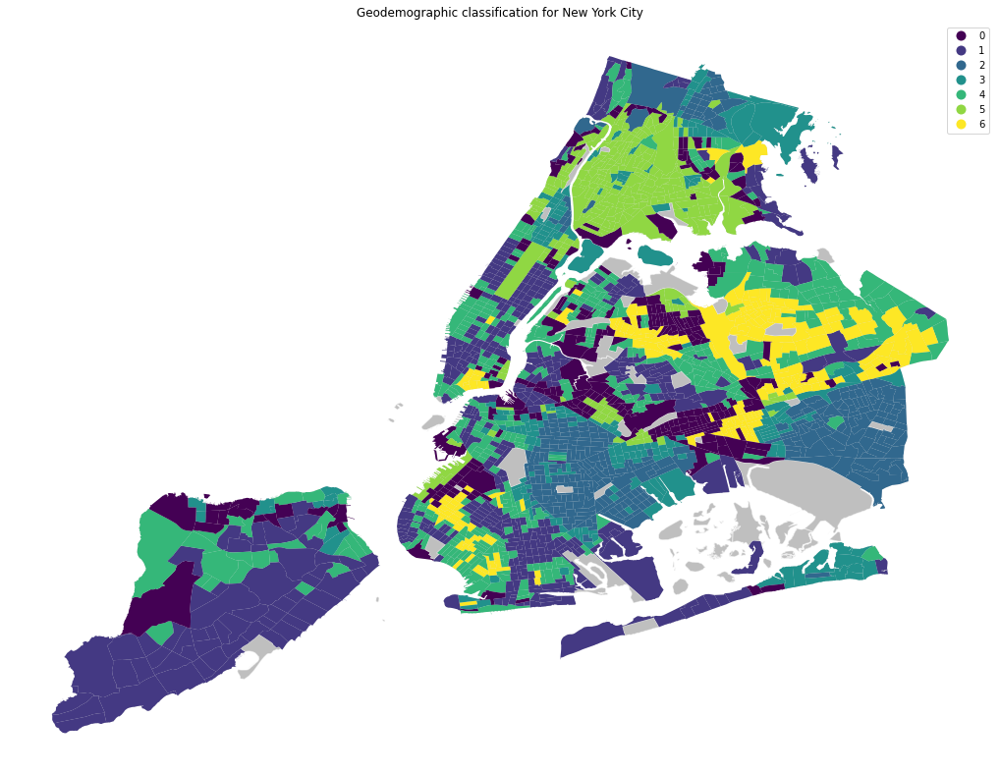

In [32]:
# Setup figure and ax
f, ax = plt.subplots(1, figsize=(18, 18))
# Plot underlying geometries of all areas 
#in light grey and white borders
nyc.plot(ax=ax, 
         facecolor="grey", 
         edgecolor="w", 
         alpha=0.5
        )
# Plot unique values choropleth including 
#a legend and with no boundary lines
nyc_to_cluster.plot(column='k7cls', 
                    categorical=True, 
                    cmap="viridis",
                    legend=True, 
                    linewidth=0, 
                    ax=ax
                   )
# Remove axis
ax.set_axis_off()
# Add title
plt.title('Geodemographic classification for New York City')
# Display the map
plt.show()

In [34]:
# Caracteristicas de los clusters
# Número de entidades por cluster
k7sizes = nyc_to_cluster.groupby('k7cls').size()
k7sizes

k7cls
0    264
1    430
2    320
3    223
4    413
5    277
6    199
dtype: int64

In [35]:
# Calcular el promedio de proporción de población por etnia
k7means = nyc_to_cluster.groupby('k7cls')[ethnicity_pcts].mean()
k7means.index.name = "Clusters"
k7means.columns.name = "Variables"
# Show the table transposed (so it's not too wide)
k7means.T

Clusters,0,1,2,3,4,5,6
Variables,,,,,,,
european_pct,36.478667,81.650263,5.313886,16.888797,58.976769,15.756216,25.371108
asian_pct,10.434360,5.840408,2.065514,4.995349,17.722670,2.751962,47.172041
american_pct,0.505982,0.256320,0.218823,0.395388,0.220422,0.453159,0.631248
african_pct,9.065880,2.090675,82.239197,51.207504,5.387043,23.901189,6.416611
hispanic_pct,40.581669,8.637680,8.429405,23.213856,15.286830,54.001587,17.303310
pacific_pct,0.064081,0.015090,0.066236,0.058651,0.056356,0.019252,0.040171
mixed_pct,2.869360,1.509564,1.666939,3.240454,2.349911,3.116635,3.065511


# 2. Regionalización de Dar Es Salaam
Para este ejercicio, se trabajara con la información de Tanzania Dar Es Salaam, estos datos describen el medio construido del centro de la ciudad.
- Densidad de construcción: número de construcciones por hexagono
- Cobertura de edificios: proporción de superficie cubierta por edificios
- Largo de calle: longitud total de calles en el haxagono
- Linealidad de calle: metrica de que tan regular es la traza en el hexagono <br><br>
A partir de esto, realice lo siguiente:<br>
Desarrolla una regionalización que particione Dar Es Salaam de acuerdo al medio construido.<br><br>
Para esto, puedes tomar las siguientes consideraciones:<br>
- Crea una matriz de pesos espaciales que capture la relación entre los hexagonos
- Establece los parametros del algoritmo de regionalización dado un número N de clusters
- Genera una geografía que contenga solo los límites para cada una de las regiones y visualizala
- Repite el proceso con varias combinaciones de variables y de clusters
- Escoge la mejor versión. ¿Por qué la elegiste? ¿Qué se muestra en ella? ¿Cuáles son los grupos principales de áreas basados en el medio construido?

AxesSubplot(0.125777,0.125;0.773445x0.755)


,index,id,street_length,street_linearity,building_density,building_coverage,geometry
0,897b4c16087ffff,897b4c8ce17ffff,0.011097,0.926700,138.0,15.789853,"POLYGON ((39.23750 -6.73264, 39.23752 -6.73071..."
1,897b4c16097ffff,897b4c8ec67ffff,0.009181,0.983710,33.0,3.722600,"POLYGON ((39.23914 -6.73559, 39.23916 -6.73366..."
2,897b4c160b3ffff,897b4c8eba3ffff,0.008357,0.962158,82.0,9.491595,"POLYGON ((39.23416 -6.73254, 39.23418 -6.73061..."
3,897b4c160b7ffff,897b4c8dd97ffff,0.021292,0.884537,122.0,7.245560,"POLYGON ((39.23082 -6.73244, 39.23084 -6.73050..."
4,897b4c16183ffff,897b4c8ce77ffff,0.008777,0.959906,113.0,11.806652,"POLYGON ((39.21745 -6.73202, 39.21747 -6.73009..."


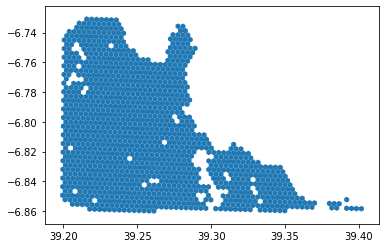

In [40]:
# Cargamos el archivo
db = gpd.read_file("http://darribas.org/gds_course/content/data/dar_es_salaam.geojson")
print (db.plot())
db.head()

In [41]:
db.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1291 entries, 0 to 1290
Data columns (total 7 columns):
 #   Column             Non-Null Count  Dtype   
---  ------             --------------  -----   
 0   index              1291 non-null   object  
 1   id                 1291 non-null   object  
 2   street_length      1291 non-null   float64 
 3   street_linearity   1291 non-null   float64 
 4   building_density   1291 non-null   float64 
 5   building_coverage  1291 non-null   float64 
 6   geometry           1291 non-null   geometry
dtypes: float64(4), geometry(1), object(2)
memory usage: 70.7+ KB


In [59]:
#
w = weights.Queen.from_dataframe(db)
#
db_region = db.drop(w.islands)
#
w = weights.Queen.from_dataframe(db_region)


In [60]:
columns = [
    "street_length",
    "street_linearity",
    "building_density",
    "building_coverage"
]

In [61]:
reg7 = cluster.AgglomerativeClustering(n_clusters=7, connectivity=w.sparse)
reg7

AgglomerativeClustering(connectivity=<1290x1290 sparse matrix of type '<class 'numpy.float64'>'
	with 7076 stored elements in Compressed Sparse Row format>,
                        n_clusters=7)

In [62]:
# Run the clustering algorithm
reg7cls = reg7.fit(db_region[columns])

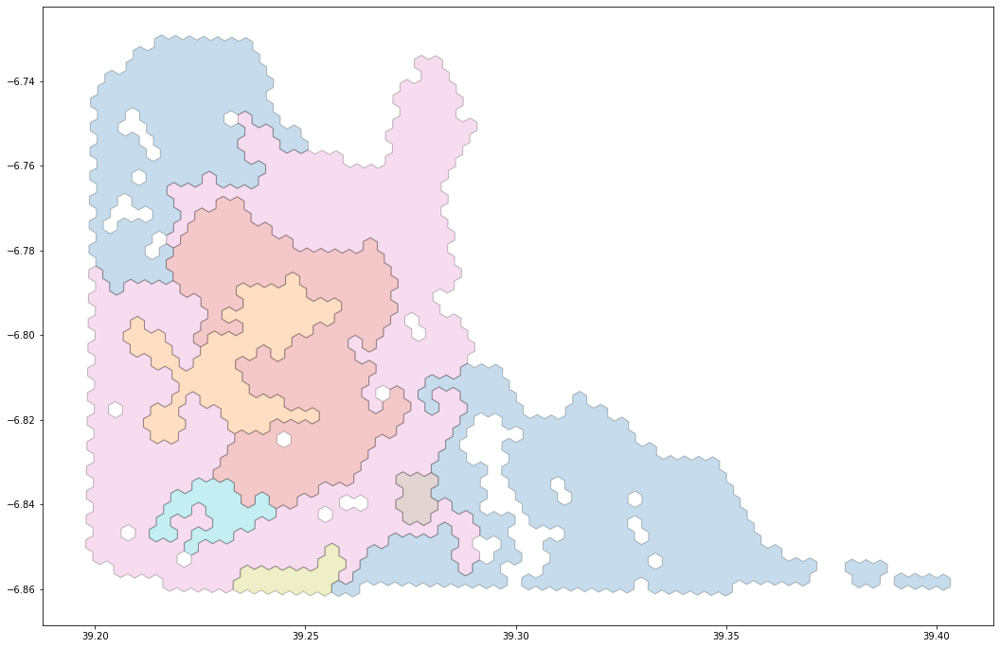

In [63]:
ax = db_region.assign(labels=reg7cls.labels_)\
                  .dissolve("labels")\
                  .reset_index()\
                  .plot(column="labels",
                        edgecolor="black",
                        alpha=0.25,
                        categorical=True,
                        figsize=(18, 18)
                       )
# cx.add_basemap(ax, 
#                       crs=db.crs, 
#                       source=cx.providers.Esri.WorldImagery
#                      )

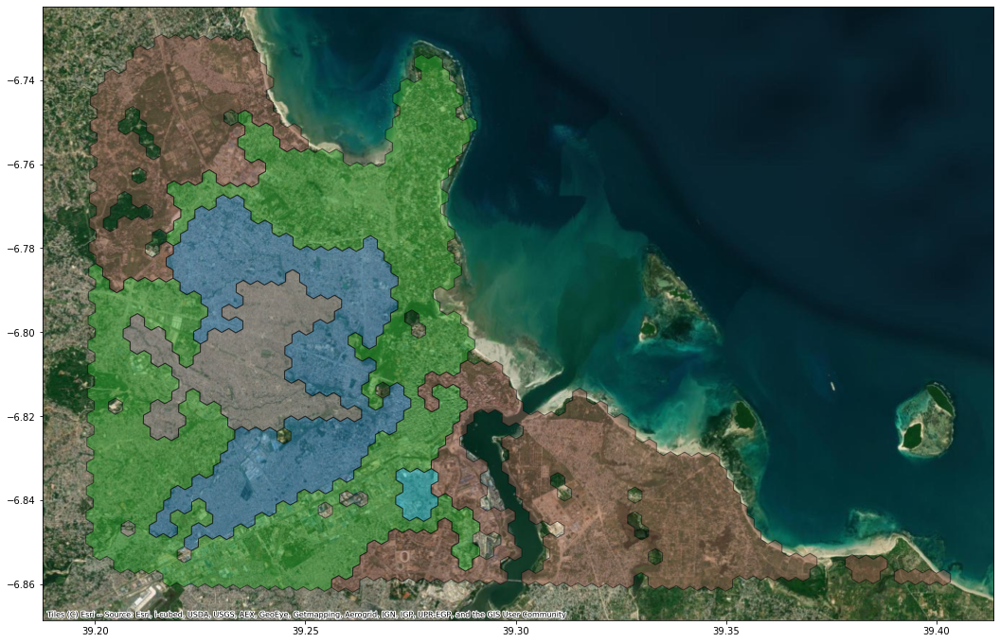

In [70]:
reg7 = cluster.AgglomerativeClustering(n_clusters=5, connectivity=w.sparse)
reg7
# 
columns = [
    "street_linearity",
    "building_density"
]
# Run the clustering algorithm
reg7cls = reg7.fit(db_region[columns])
# 
ax = db_region.assign(labels=reg7cls.labels_)\
                  .dissolve("labels")\
                  .reset_index()\
                  .plot(column="labels",
                        edgecolor="black",
                        alpha=0.5,
                        categorical=True,
                        figsize=(18,18)
                       )
cx.add_basemap(ax, 
                       crs=db.crs, 
                       source=cx.providers.Esri.WorldImagery
                      )